# Xopt Parallel Examples

Xopt provides methods to parallelize optimizations using Processes, Threads, MPI, and Dask using the `concurrent.futures` interface as defined in  https://www.python.org/dev/peps/pep-3148/ .

In [1]:
from xopt import Xopt

In [2]:
# Helpers for this notebook
import multiprocessing
N_CPUS=multiprocessing.cpu_count()
N_CPUS

64

In [3]:
import os

# directory for data. 
os.makedirs("temp", exist_ok=True)

# Notebook printing output
#from xopt import output_notebook
#output_notebook()

# Nicer plotting
%config InlineBackend.figure_format = 'retina'

The `Xopt` object can be instantiated from a JSON or YAML file, or a dict, with the proper structure.

Here we will make one

In [4]:
# Make a proper input file.
YAML = """
xopt:
  asynch: True
  max_evaluations: 1000
  dump_file: dump.yaml
  
generator:
  name: cnsga
  output_path: temp
  population_size:  16

evaluator:
  function: shaping.evaluate_splice_flat

vocs:
  variables:
    p1: [0, 1]
    p2: [0, 1]
    p3: [0, 1]
    p4: [0, 1]
    p5: [0, 1]
    p6: [0, 1]
    p7: [0, 1]
    p8: [0, 1]
    sig_t: [0.01,0.1]
  objectives:
    entropy: 'MINIMIZE'  
  constraints:
    norm_emit_x: [LESS_THAN, 1e-5]
    n_alive: [GREATER_THAN, 8000]

"""
X = Xopt(YAML)
X


            Xopt
________________________________
Version: 1.2.6
Data size: 0
Config as YAML:
xopt: {asynch: true, strict: false, dump_file: dump.yaml, max_evaluations: 1000}
generator: {name: cnsga, population_size: 16, crossover_probability: 0.9, mutation_probability: 1.0,
  population_file: null, output_path: temp}
evaluator:
  function: shaping.evaluate_splice_flat
  max_workers: 1
  function_kwargs: {}
  vectorized: false
vocs:
  variables:
    p1: [0.0, 1.0]
    p2: [0.0, 1.0]
    p3: [0.0, 1.0]
    p4: [0.0, 1.0]
    p5: [0.0, 1.0]
    p6: [0.0, 1.0]
    p7: [0.0, 1.0]
    p8: [0.0, 1.0]
    sig_t: [0.01, 0.1]
  constraints:
    norm_emit_x: [LESS_THAN, 1.0e-05]
    n_alive: [GREATER_THAN, 8000.0]
  objectives: {entropy: MINIMIZE}
  constants: {}
  linked_variables: {}


In [ ]:
%%timeit
# Check that the average time is close to random_sleep
X.evaluator.function({"p1": 0.5, "p2": 0.5, "p3":0.5, "p4":0.5})

In [5]:
%%time
X.step()

wrote temp/585027523862612738.h5
[MESSAGE | 2023-MAY-09 13:35:29] tao_init:
    OpenMP active with number of threads: 1

Tao: set beam_init n_particle = 10000

Tao: set global track_type = beam
Beam at Element: 3. Time: 11 min
Beam at Element: 4. Time: 13 min
Beam at Element: 6. Time: 17 min
Beam at Element: 10. Time: 19 min
Beam at Element: 12. Time: 20 min
Beam at Element: 14. Time: 22 min
Beam at Element: 16. Time: 23 min
Beam at Element: 18. Time: 25 min
Beam at Element: 20. Time: 26 min
Beam at Element: 22. Time: 28 min
Beam at Element: 26. Time: 29 min
Beam at Element: 31. Time: 31 min
Beam at Element: 35. Time: 33 min
Beam at Element: 37. Time: 34 min
Beam at Element: 39. Time: 36 min
Beam at Element: 41. Time: 37 min
Beam at Element: 43. Time: 39 min
Beam at Element: 45. Time: 40 min
Beam at Element: 49. Time: 41 min
Beam at Element: 53. Time: 43 min
[ERROR | 2023-MAY-09 14:18:20] track1:
    STARTING ORBIT NOT PROPERLY INITIALIZED! [NEEDS AN INIT_COORD CALL?]
    TRACKING THRO

In [ ]:
%%time
X.run()

In [7]:
X.data

,p1,p2,p3,p4,p5,p6,p7,p8,xopt_runtime,xopt_error,xopt_error_str
1,0.346098,0.929757,0.442817,0.686662,0.552528,0.858908,0.401004,0.969521,0.014456,True,"Traceback (most recent call last):\n File ""/n..."


# Analysis

In [1]:
import shaping
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import h5py
from pmd_beamphysics import ParticleGroup, particle_paths
from distgen import Generator
from distgen.metrics import kullback_liebler_div, res2
from distgen.physical_constants import unit_registry
from distgen.dist import SuperGaussian 

In [2]:
L = 200*unit_registry('ps')
avg_t_sg = 0*unit_registry('ps')
sigma_t_sg = L/np.sqrt(12)
sg = SuperGaussian('t', avg_t=avg_t_sg, sigma_t=sigma_t_sg, p=12)
tsg, Psg = sg.get_x_pts(), sg.pdf()

In [8]:
p = shaping.read_particles('temp/8114076126596982142end.h5')[-1]

read temp/8114076126596982142end.h5


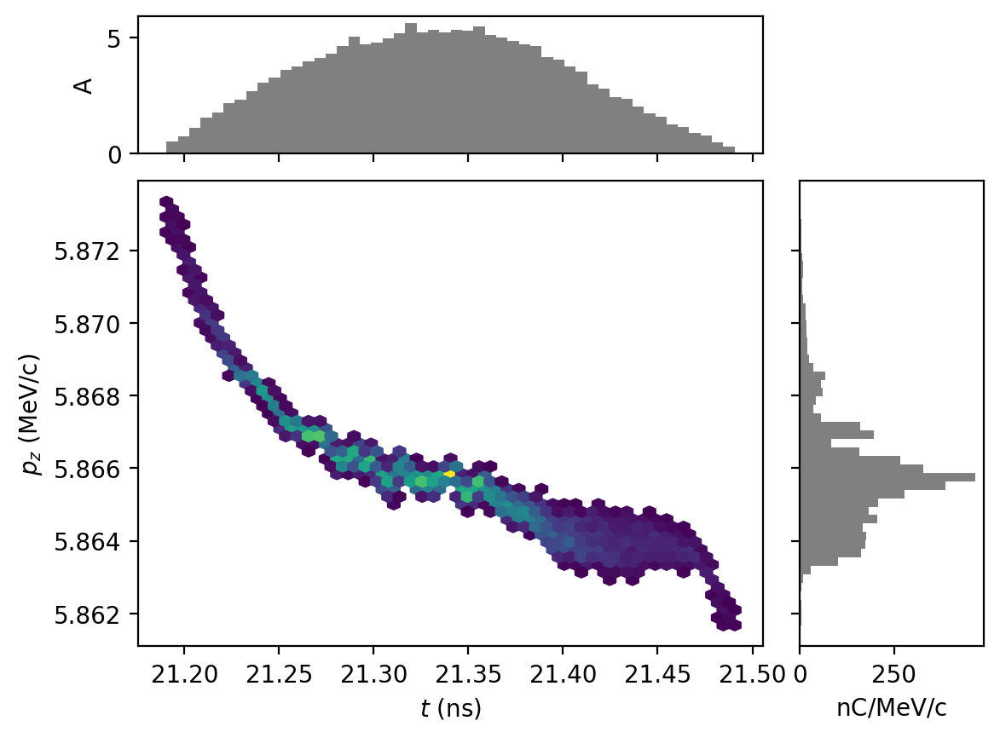

In [9]:
P = ParticleGroup('temp/5424615070899434227end.h5')
P.plot('t','pz')

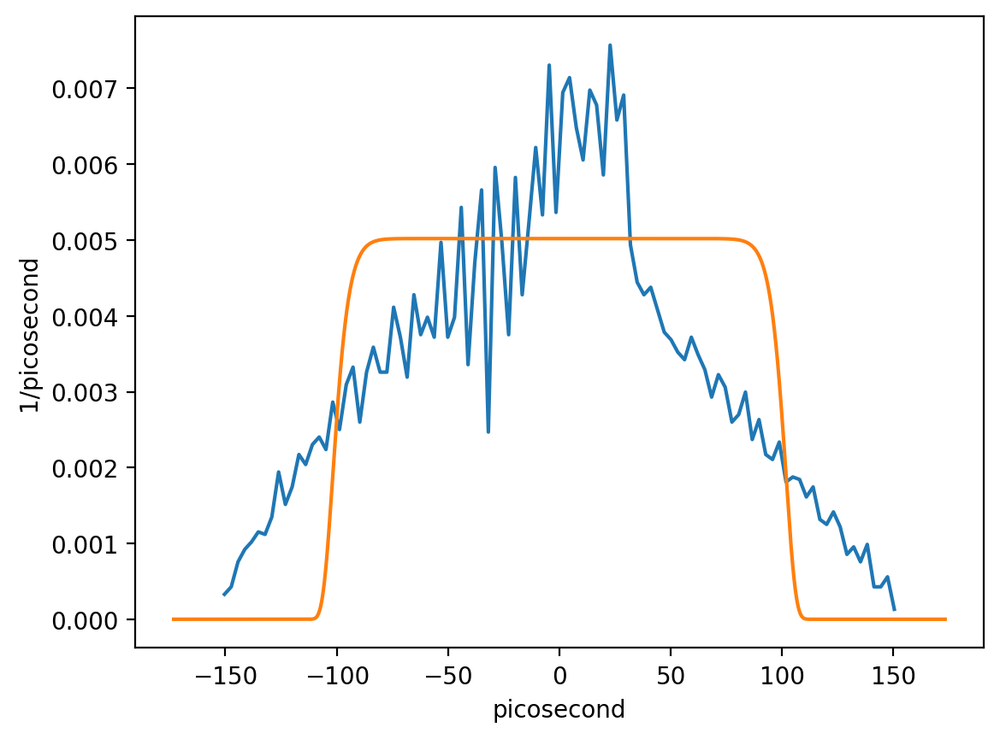

In [22]:
datar = list()
alive = (p['status']==1)
datar.append(p['t'][alive])
d = np.histogram(datar, bins=100, density=True)

ps = d[0]
ts = shaping.array_to_middle_values(d[1])
ts = ts - np.average(ts)
ts = ts * 1e12 * unit_registry('ps')
ps = ps / 1e12 / unit_registry('ps')


plt.plot(ts,ps)
plt.plot(tsg,Psg)

In [85]:
kullback_liebler_div(ts, ps, tsg, Psg)

8.029841816517125

In [73]:
pi = shaping.read_particles("/nfs/user/nw285/bmad_benchmarking/cooler_injector/v2/test.h5")[-1]

read /nfs/user/nw285/bmad_benchmarking/cooler_injector/v2/test.h5


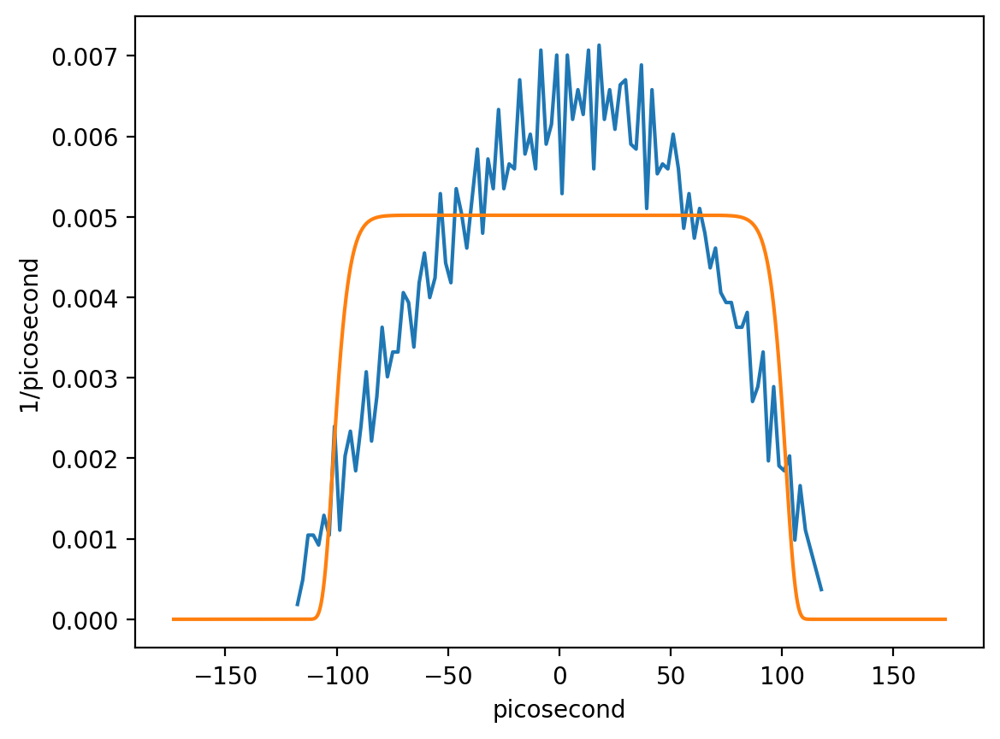

In [82]:
datar = list()
alive = (p['status']==1)
datar.append(p['t'][alive])
d = np.histogram(datar, bins=100, density=True)

ps = d[0]
ts = shaping.array_to_middle_values(d[1])
ts = ts - np.average(ts)
ts = ts * 1e12 * unit_registry('ps')
ps = ps / 1e12 / unit_registry('ps')


plt.plot(ts,ps)
plt.plot(tsg,Psg)

# MPI 

The `test.yaml` file completely defines the problem. We will also direct the logging to an `xopt.log` file. The following invocation recruits 4 MPI workers to solve this problem.

We can also continue by calling `.save` with a JSON filename. This will write all of previous results into the file.

In [5]:
X = Xopt(YAML)
X.yaml('test.yaml') # Write this input to file
!cat test.yaml

xopt: {asynch: true, strict: false, dump_file: dump.yaml, max_evaluations: 1000}
generator: {name: cnsga, population_size: 16, crossover_probability: 0.9, mutation_probability: 1.0,
  population_file: null, output_path: temp}
evaluator:
  function: shaping.evaluate_splice_flat
  max_workers: 1
  function_kwargs: {}
  vectorized: false
vocs:
  variables:
    p1: [0.0, 1.0]
    p2: [0.0, 1.0]
    p3: [0.0, 1.0]
    p4: [0.0, 1.0]
    p5: [0.0, 1.0]
    p6: [0.0, 1.0]
    p7: [0.0, 1.0]
    p8: [0.0, 1.0]
    sig_t: [0.01, 0.1]
  constraints:
    norm_emit_x: [LESS_THAN, 1.0e-05]
    n_alive: [GREATER_THAN, 8000.0]
  objectives: {entropy: MINIMIZE}
  constants: {}
  linked_variables: {}


In [ ]:
%%time
!mpirun -n {28} python -m mpi4py.futures -m xopt.mpi.run -vv --logfile xopt.log test.yaml

Namespace(input_file='test.yaml', logfile='xopt.log', verbose=2)
Parallel execution with 28 workers
Initializing Xopt object
Initializing generator cnsga,
Created toolbox with 9 variables, 2 constraints, and 1 objectives.
    Using selection algorithm: nsga2
Initializing Xopt object
Xopt object initialized
Enabling async mode

            Xopt
________________________________
Version: 1.2.6
Data size: 0
Config as YAML:
xopt: {asynch: true, strict: false, dump_file: dump.yaml, max_evaluations: 1000}
generator: {name: cnsga, population_size: 16, crossover_probability: 0.9, mutation_probability: 1.0,
  population_file: null, output_path: temp}
evaluator:
  function: shaping.evaluate_splice_flat
  max_workers: 1
  function_kwargs: {}
  vectorized: false
vocs:
  variables:
    p1: [0.0, 1.0]
    p2: [0.0, 1.0]
    p3: [0.0, 1.0]
    p4: [0.0, 1.0]
    p5: [0.0, 1.0]
    p6: [0.0, 1.0]
    p7: [0.0, 1.0]
    p8: [0.0, 1.0]
    sig_t: [0.01, 0.1]
  constraints:
    norm_emit_x: [LESS_THAN, 1.

In [ ]:
%%time
!mpirun -n {28} python -m mpi4py.futures -m xopt.mpi.run -vv --logfile xopt.log dump.yaml

Namespace(input_file='dump.yaml', logfile='xopt.log', verbose=2)
Parallel execution with 28 workers
Initializing Xopt object
Initializing generator cnsga,
Created toolbox with 9 variables, 2 constraints, and 1 objectives.
    Using selection algorithm: nsga2
Initializing Xopt object
Xopt object initialized
Enabling async mode

            Xopt
________________________________
Version: 1.2.6
Data size: 526
Config as YAML:
xopt: {asynch: true, strict: false, dump_file: dump.yaml, max_evaluations: 1000}
generator: {name: cnsga, population_size: 16, crossover_probability: 0.9, mutation_probability: 1.0,
  population_file: null, output_path: temp}
evaluator:
  function: shaping.evaluate_splice_flat
  max_workers: 28
  function_kwargs: {}
  vectorized: false
vocs:
  variables:
    p1: [0.0, 1.0]
    p2: [0.0, 1.0]
    p3: [0.0, 1.0]
    p4: [0.0, 1.0]
    p5: [0.0, 1.0]
    p6: [0.0, 1.0]
    p7: [0.0, 1.0]
    p8: [0.0, 1.0]
    sig_t: [0.01, 0.1]
  constraints:
    n_alive: [GREATER_THAN, 

In [20]:
!tail xopt.log

2023-04-25T23:19:20-0400 - xopt.base - INFO - Xopt object initialized
2023-04-25T23:19:20-0400 - xopt - INFO - Enabling async mode
2023-04-25T23:19:20-0400 - xopt.base - INFO - Running Xopt step
2023-04-25T23:33:22-0400 - xopt.base - INFO - Running Xopt step
2023-04-25T23:33:32-0400 - xopt.base - INFO - Running Xopt step
2023-04-25T23:33:38-0400 - xopt.base - INFO - Running Xopt step
2023-04-25T23:33:59-0400 - xopt.base - INFO - Running Xopt step
2023-04-25T23:34:00-0400 - xopt.base - INFO - Running Xopt step
2023-04-25T23:34:00-0400 - xopt.base - INFO - Running Xopt step
2023-04-25T23:34:01-0400 - xopt.base - INFO - Running Xopt step


In [11]:
X.data

""


In [6]:
X=Xopt('dump.yaml')
X.data

,ID,entropy,n_alive,norm_emit_x,p1,p2,p3,p4,p5,p6,p7,p8,sig_t,xopt_error,xopt_runtime
1,3475620629168214642,0.001094,10000,0.000003,0.605688,0.537492,0.521220,0.017146,0.856680,0.391041,0.459023,0.502214,0.075340,False,3129.274799
10,1148361813311105669,0.000457,10000,0.000006,0.876261,0.794696,0.169844,0.570493,0.644512,0.631109,0.567044,0.424768,0.022733,False,2938.683296
100,48180541625691398,0.000463,10000,0.000006,0.876261,0.790515,0.169844,0.570493,0.644512,0.636854,0.567146,0.424768,0.022733,False,2967.039945
101,4497833473275918965,0.000444,10000,0.000007,0.368188,0.882621,0.640049,0.039534,0.697432,0.920420,0.550758,0.420892,0.024430,False,3002.206710
102,4137772465133054380,0.000443,10000,0.000006,0.399153,0.100394,0.090843,0.614996,0.467089,0.658833,0.072159,0.414921,0.038413,False,3118.581349
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,7337610093700683250,0.000513,10000,0.000003,0.717710,0.940108,0.534322,0.837576,0.516998,0.805886,0.845535,0.020994,0.049120,False,2984.467261
96,2394632219965856083,0.000470,10000,0.000008,0.291694,0.131345,0.319813,0.394964,0.692740,0.052647,0.820871,0.421054,0.027072,False,3070.226940
97,4060695611546588818,0.000475,10000,0.000006,0.365504,0.764404,0.658680,0.055471,0.406007,0.493239,0.552456,0.408775,0.024884,False,3026.246771
98,3634529900835235969,0.000402,10000,0.000006,0.545103,0.206927,0.086392,0.920302,0.511247,0.786691,0.217918,0.633276,0.037202,False,3150.603097


In [8]:
X.data['entropy'].idxmin(),X.data['entropy'].min()

('920', 0.0001705379)

In [9]:
X.data[X.data['entropy']==X.data['entropy'].min()]

,ID,entropy,n_alive,norm_emit_x,p1,p2,p3,p4,p5,p6,p7,p8,sig_t,xopt_error,xopt_runtime
920,9017103540954861235,0.000171,10000,0.000009,0.9413,0.155231,0.928726,0.94876,0.534517,0.152852,0.065493,0.474839,0.026238,False,4710.829321


In [32]:
idxa = list()
entropy = list()
for index, row in X.data.iterrows():
    idxa.append(index)
    entropy.append(row['entropy'])

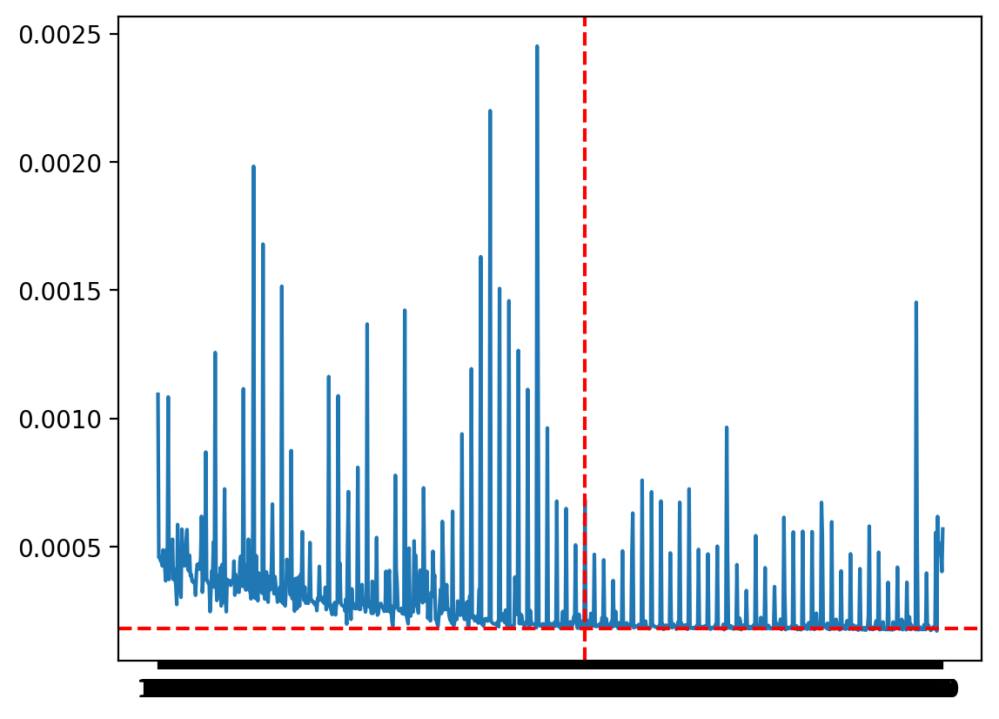

In [35]:
plt.plot(idxa,entropy)
plt.axvline(500,color='r',ls='--')
plt.axhline(0.00018,color='r',ls='--')

In [3]:
from pmd_beamphysics import ParticleGroup, particle_paths
p=ParticleGroup('temp/9017103540954861235end.h5')

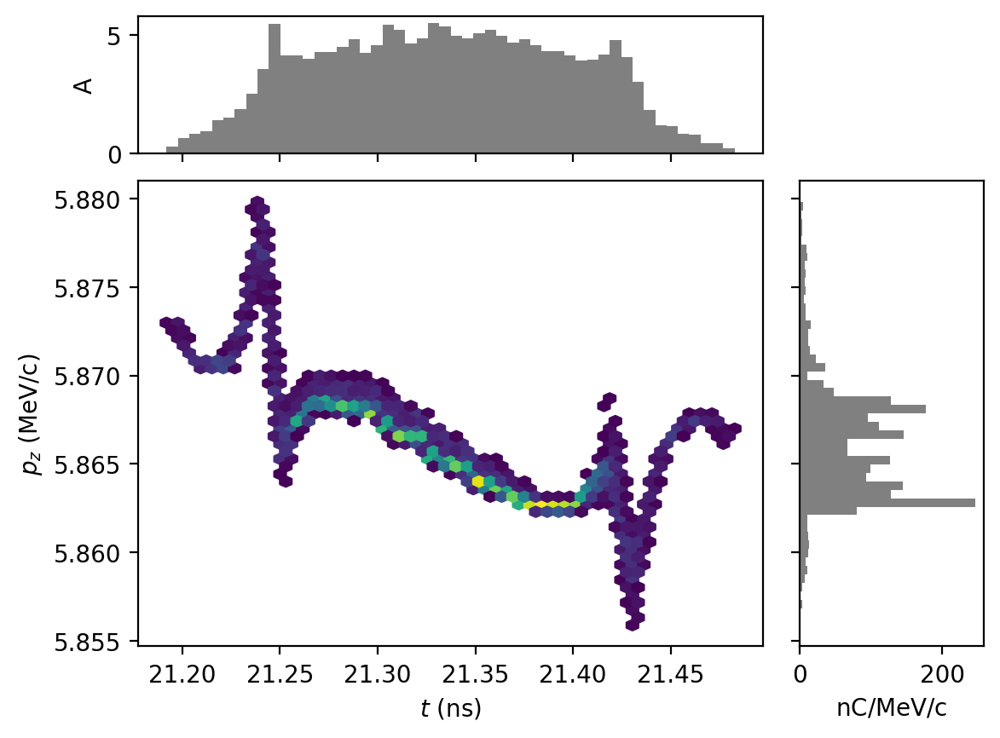

In [12]:
p.plot('t','pz')

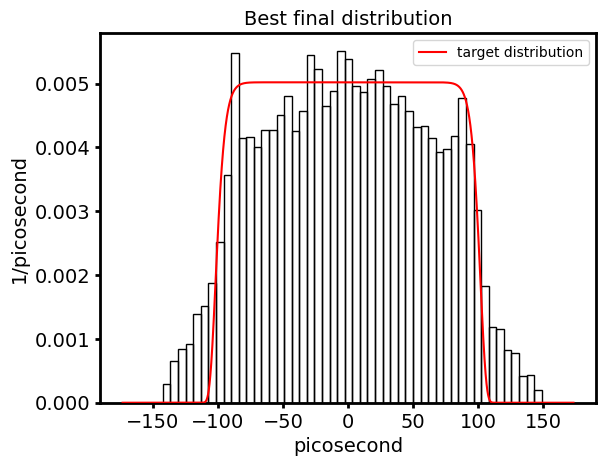

In [15]:
datar = list()
p = ParticleGroup(f"temp/9017103540954861235end.h5")
alive = (p['status']==1)
datar.append(p['t'][alive]*1e12 - p['mean_t']*1e12)
d = np.histogram(datar, bins=100)

ps = d[0]
ts = shaping.array_to_middle_values(d[1])
ts = ts - np.average(ts)
ts = ts * 1e12 * unit_registry('ps')
ps = ps / 1e12 / unit_registry('ps')

#plt.plot(ts,ps)
fig, ax = plt.subplots()
ln1 = ax.hist(datar, bins=50, fill=False, label='final distribution', density=True)
ax2=ax.twinx()
ln2 = ax2.plot(tsg,Psg,color='r', label='target distribution')

for axis in ['top', 'bottom', 'left', 'right']:
    ax.spines[axis].set_linewidth(2)
ax.xaxis.set_tick_params(width=2)
ax.yaxis.set_tick_params(width=2)
ax.set_xlabel('picosecond', fontsize=14)
ax.set_ylabel('1/picosecond', fontsize=14)
ax.set_title('Best final distribution', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=14)

ax2.set_ylim(ax.get_ylim())
ax2.set_yticks([])
ax2.set_ylabel('')
ax2.tick_params(axis='both', which='major', labelsize=14)

plt.legend()
#fig.savefig('fig/best_final.pdf')

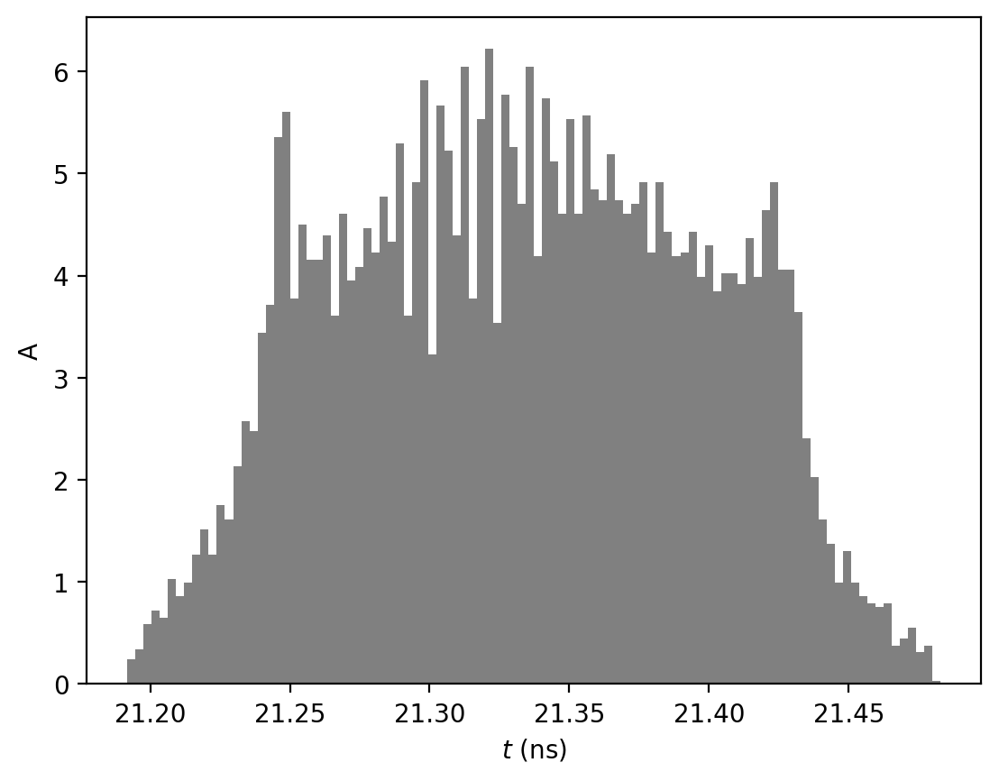

In [14]:
p.plot('t')

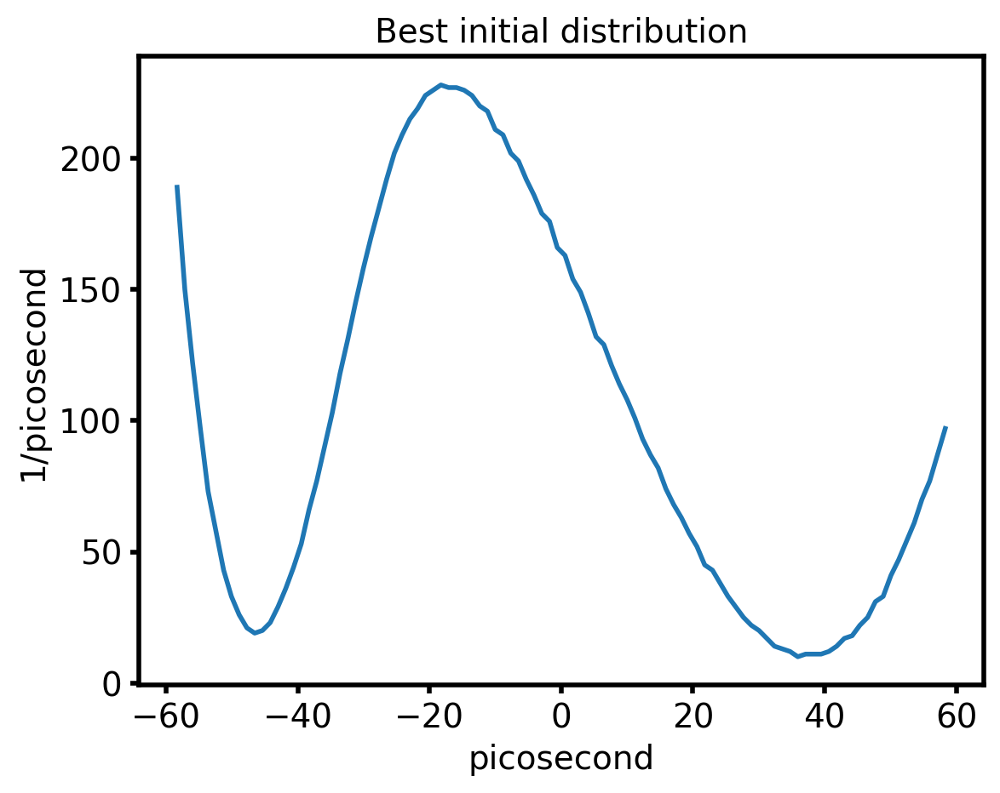

In [15]:
datar = list()
p = ParticleGroup(f"temp/9017103540954861235.h5")
datar.append(p['t']*1e12 - p['mean_t']*1e12)
d = np.histogram(datar, bins=100)

ps = d[0]
ts = shaping.array_to_middle_values(d[1])
ts = ts - np.average(ts)
ts = ts  * unit_registry('ps')
ps = ps  / unit_registry('ps')

#plt.plot(ts,ps)
fig, ax = plt.subplots()
ax.plot(ts,ps, label='Best initial distribution', linewidth=2)

for axis in ['top', 'bottom', 'left', 'right']:
    ax.spines[axis].set_linewidth(2)
ax.xaxis.set_tick_params(width=2)
ax.yaxis.set_tick_params(width=2)
ax.set_xlabel('picosecond', fontsize=14)
ax.set_ylabel('1/picosecond', fontsize=14)
ax.set_title('Best initial distribution', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=14)

#plt.legend()
#fig.savefig('fig/best_init.jpg')

In [130]:
p=ParticleGroup('temp/4004028212491418330.h5')

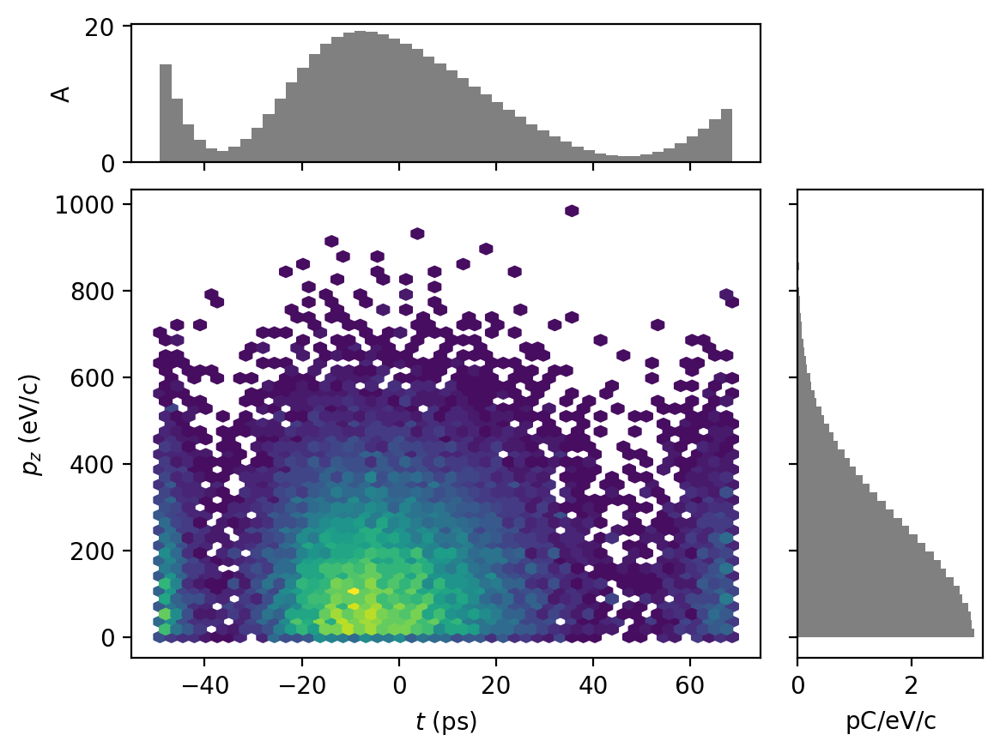

In [36]:
p.plot('t','pz')

read temp/8774367561665221019end.h5
read temp/471409086855008019end.h5
read temp/4919677106421965436end.h5
read temp/7159808264588332368end.h5
read temp/6674663299581430670end.h5
read temp/2950802612394599541end.h5
read temp/7197624316947323144end.h5
read temp/7431763567581826312end.h5
read temp/4567603198953706652end.h5


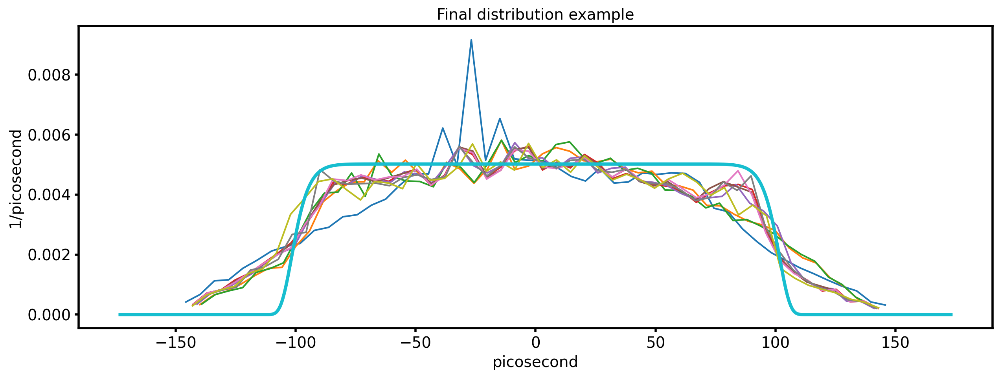

In [38]:
count = 2
fig, ax = plt.subplots(1,1, figsize=(15,5))
for i in X.data['ID']:
    count = (count + 1) % 100
    if count!=0: continue
    datar = list()
    P = shaping.read_particles(f"temp/{i}end.h5")[-1]
    alive = (P['status']==1)
    datar.append(P['t'][alive])
    d = np.histogram(datar, bins=50, density=True)

    ps = d[0]
    ts = shaping.array_to_middle_values(d[1])
    ts = ts - np.average(ts)
    ts = ts * 1e12 * unit_registry('ps')
    ps = ps / 1e12 / unit_registry('ps')

    plt.plot(ts,ps)
plt.plot(tsg,Psg,linewidth=3)
for axis in ['top', 'bottom', 'left', 'right']:
    ax.spines[axis].set_linewidth(2)
ax.xaxis.set_tick_params(width=2)
ax.yaxis.set_tick_params(width=2)
ax.set_xlabel('picosecond', fontsize=14)
ax.set_ylabel('1/picosecond', fontsize=14)
ax.set_title('Final distribution example', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=14)
#fig.savefig('fig/sample_final.pdf')

# Load output into Pandas

This algorithm writes two types of files: `gen_{i}.json` with all of the new individuals evaluated in a generation, and `pop_{i}.json` with the latest best population. Xopt provides some functions to load these easily into a Pandas dataframe for further analysis.

In [9]:
import pandas as pd

In [8]:
X.data

,entropy,norm_emit_x,p1,p2,p3,p4,xopt_error,xopt_runtime
1,0.017976,6.051000e-07,0.248770,0.886793,0.848919,0.720344,False,435.496442
10,0.019314,6.363000e-07,0.369079,0.447139,0.446344,0.471839,False,385.724076
11,0.022559,9.086000e-07,0.071617,0.379933,0.734647,0.880995,False,400.518618
12,0.020109,7.443000e-07,0.749311,0.413680,0.700341,0.098935,False,388.040130
13,0.029818,5.828000e-07,0.658623,0.723707,0.058669,0.092414,False,382.496014
14,0.018524,5.577000e-07,0.378270,0.593314,0.500800,0.490390,False,442.633684
15,0.027524,1.451600e-06,0.421842,0.070465,0.322190,0.993592,False,433.169179
17,0.018216,4.844000e-07,0.406157,0.867009,0.275334,0.689746,False,446.026844
2,0.034835,8.195000e-07,0.105743,0.067508,0.988234,0.970060,False,411.083223
3,0.018997,7.478000e-07,0.247592,0.679337,0.879241,0.859287,False,445.113666


In [10]:
df = pd.concat([X.data, X.vocs.feasibility_data(X.data)], axis=1)
df[df['feasible']]

,entropy,norm_emit_x,p1,p2,p3,p4,xopt_error,xopt_runtime,feasible_norm_emit_x,feasible
1,0.000355,0.000008,0.651701,0.315050,0.132647,0.235100,False,2127.441842,True,True
10,0.000310,0.000005,0.552869,0.407861,0.812914,0.411790,False,1815.200407,True,True
11,0.000376,0.000006,0.052431,0.220501,0.354903,0.580512,False,1804.306207,True,True
12,0.000299,0.000007,0.135353,0.608231,0.220750,0.160569,False,1718.690612,True,True
13,0.000373,0.000006,0.924199,0.964067,0.443762,0.898241,False,1817.619309,True,True
14,0.000344,0.000004,0.231084,0.808345,0.931460,0.637336,False,2083.375090,True,True
15,0.000335,0.000005,0.687353,0.392928,0.731303,0.171745,False,2079.307732,True,True
16,0.000321,0.000004,0.595039,0.873724,0.638329,0.313231,False,2115.088386,True,True
17,0.000508,0.000006,0.793780,0.378062,0.240504,0.959322,False,2076.090830,True,True
19,0.000387,0.000009,0.696443,0.065507,0.641055,0.270045,False,1710.732051,True,True


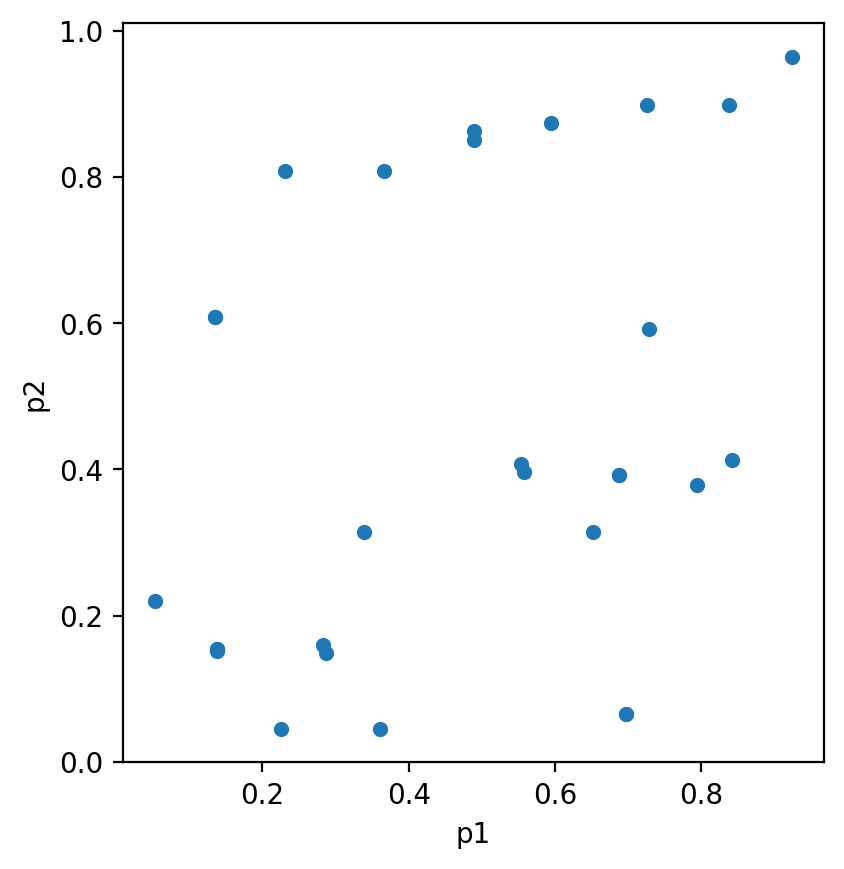

In [11]:
# Plot the feasible ones
feasible_df = df[df["feasible"]]
feasible_df.plot("p1", "p2", kind="scatter").set_aspect("equal")

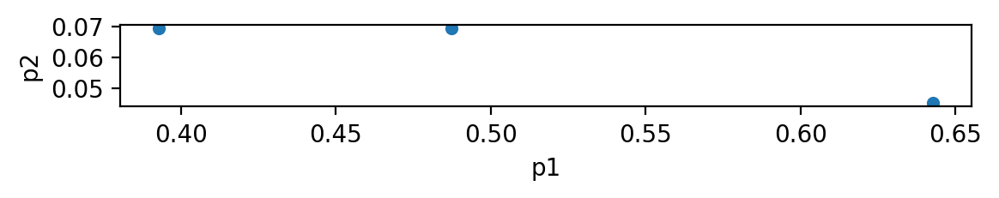

In [12]:
# Plot the infeasible ones
infeasible_df = df[~df["feasible"]]
infeasible_df.plot("p1", "p2", kind="scatter").set_aspect("equal")

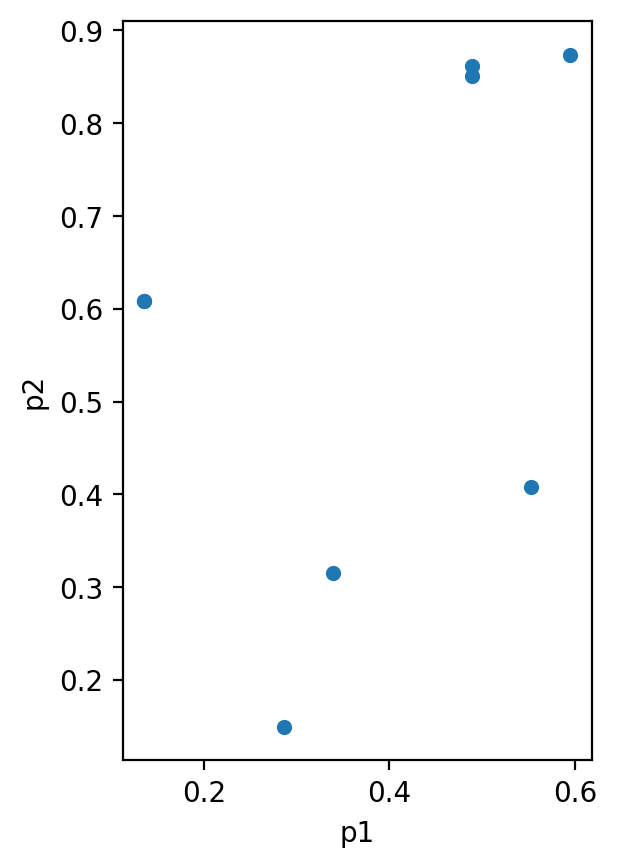

In [13]:
# This is the final population
df1 = X.generator.population
df1.plot("p1", "p2", kind="scatter").set_aspect("equal")

# matplotlib plotting

You can always use matplotlib for customizable plotting

In [14]:
import matplotlib.pyplot as plt

%matplotlib inline

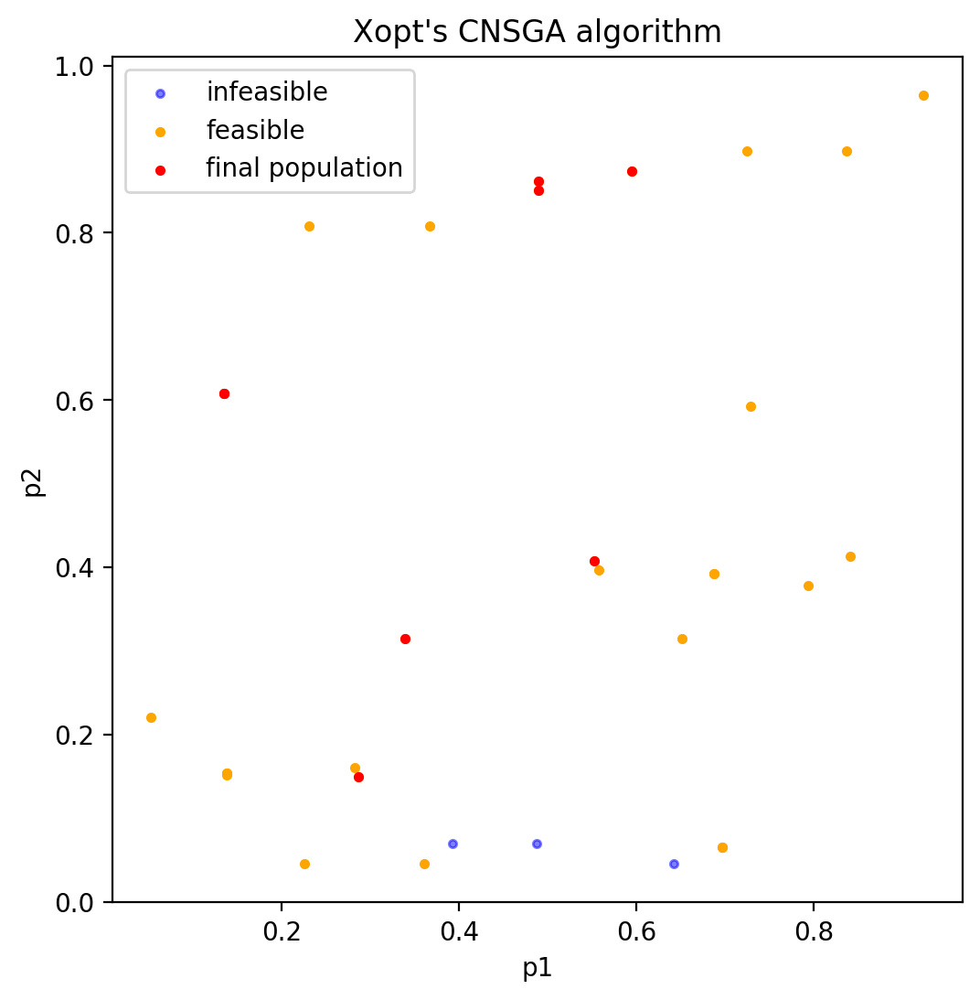

In [15]:
# Extract objectives from output
k1, k2 = "p1", "p2"

fig, ax = plt.subplots(figsize=(6, 6))

ax.scatter(
    infeasible_df[k1],
    infeasible_df[k2],
    color="blue",
    marker=".",
    alpha=0.5,
    label="infeasible",
)
ax.scatter(
    feasible_df[k1], feasible_df[k2], color="orange", marker=".", label="feasible"
)
ax.scatter(df1[k1], df1[k2], color="red", marker=".", label="final population")
ax.set_xlabel(k1)
ax.set_ylabel(k2)
ax.set_aspect("auto")
ax.set_title(f"Xopt's CNSGA algorithm")
plt.legend()

In [28]:
# Cleanup
!rm -r dask-worker-space
!rm -r temp
!rm xopt.log*
!rm test.yaml

rm: cannot remove ‘dask-worker-space’: No such file or directory
